In [4]:
import pandas as pd
import numpy as np
from dateutil.parser import parse 
import matplotlib
import matplotlib.pyplot as plt
from numpy.random import randn
from pandas import Series, DataFrame
from pylab import rcParams
import seaborn as sns
%matplotlib inline
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix

In [5]:
df = pd.read_csv(r"C:\Users\arrah\Desktop\Trendminer_Intern\CoffeeML1.csv", parse_dates =["timestamp"])

count_row = df.shape[0]  # gives number of row count
count_column = df.shape[1] # gives number of column count

print('Number of rows: {}'.format(count_row))
print('Number of columns: {}'.format(count_column))

df.head()

Number of rows: 13588472
Number of columns: 11


,timestamp,AnalogVibrationSensor.vibrationTotal,TemperatureAndHumiditySensor.humidity,AnalogNoiseSensor.noiseDiff,TemperatureAndHumiditySensor.temperature,AnalogNoiseSensor.noiseRange,AnalogVibrationSensor.vibrationDiff,AnalogVibrationSensor.vibrationRange,VibrationThresholdSensor.vibrationThreshold,AnalogNoiseSensor.noiseTotal,Keypad.keyPressed
0,2020-07-16 00:00:00.024000+00:00,NaN,NaN,12.0,NaN,17.0,NaN,NaN,NaN,15091.0,NaN
1,2020-07-16 00:00:00.026000+00:00,1548.0,NaN,NaN,NaN,NaN,0.0,2.0,1.0,NaN,NaN
2,2020-07-16 00:00:00.134000+00:00,NaN,NaN,3.0,NaN,11.0,NaN,NaN,NaN,14695.0,NaN
3,2020-07-16 00:00:00.135000+00:00,1550.0,NaN,NaN,NaN,NaN,0.0,2.0,1.0,NaN,NaN
4,2020-07-16 00:00:00.236000+00:00,NaN,NaN,6.0,NaN,6.0,NaN,NaN,NaN,15082.0,NaN


Selecting the period during office hours.

In [6]:
#data_0 = df1.drop(df1['2020-07-16 00:00:00':'2020-07-16 07:50:00'].index)
df['timestamp'] = pd.to_datetime(df['timestamp'])
startDate=['2020-07-16 05:00:00','2020-07-17 05:00:00','2020-07-18 05:00:00','2020-07-19 05:00:00','2020-07-20 05:00:00','2020-07-21 05:00:00','2020-07-22 05:00:00']
endDate=['2020-07-16 17:00:00','2020-07-17 17:00:00','2020-07-18 17:00:00','2020-07-19 17:00:00','2020-07-20 17:00:00','2020-07-21 17:00:00','2020-07-22 17:00:00']
#data_0[data_0.timestamp<endDate & startDate]
#df[df['timestamp']>= startDate & df ['timestamp']<= endDate]
result = []
for i in  range(0, len(startDate)) :
    start = startDate[i]
    end = endDate[i]
    result.append((df['timestamp'] > start) & (df['timestamp'] <= end)) 

resultDf = []
for item in result:
    if len(item)>0:
        resultDf.append(df.loc[item])

merged_df = pd.concat(resultDf)
merged_df


,timestamp,AnalogVibrationSensor.vibrationTotal,TemperatureAndHumiditySensor.humidity,AnalogNoiseSensor.noiseDiff,TemperatureAndHumiditySensor.temperature,AnalogNoiseSensor.noiseRange,AnalogVibrationSensor.vibrationDiff,AnalogVibrationSensor.vibrationRange,VibrationThresholdSensor.vibrationThreshold,AnalogNoiseSensor.noiseTotal,Keypad.keyPressed
404347,2020-07-16 05:00:00.004000+00:00,NaN,NaN,3.0,NaN,11.0,NaN,NaN,NaN,12323.0,NaN
404348,2020-07-16 05:00:00.005000+00:00,1545.0,NaN,NaN,NaN,NaN,0.0,2.0,1.0,NaN,NaN
404349,2020-07-16 05:00:00.115000+00:00,NaN,NaN,7.0,NaN,11.0,NaN,NaN,NaN,13651.0,NaN
404350,2020-07-16 05:00:00.116000+00:00,1556.0,NaN,NaN,NaN,NaN,0.0,2.0,1.0,NaN,NaN
404351,2020-07-16 05:00:00.216000+00:00,NaN,NaN,4.0,NaN,9.0,NaN,NaN,NaN,14924.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...
13021748,2020-07-22 16:59:59.772000+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN
13021749,2020-07-22 16:59:59.872000+00:00,NaN,NaN,1.0,NaN,9.0,NaN,NaN,NaN,14843.0,NaN
13021750,2020-07-22 16:59:59.880000+00:00,1556.0,NaN,NaN,NaN,NaN,0.0,2.0,1.0,NaN,NaN
13021751,2020-07-22 16:59:59.991000+00:00,NaN,NaN,18.0,NaN,19.0,NaN,NaN,NaN,14696.0,NaN


In [48]:
df_1 = merged_df[4600000:4800000] #  100000 rows of dataframe
df_1

,timestamp,AnalogVibrationSensor.vibrationTotal,TemperatureAndHumiditySensor.humidity,AnalogNoiseSensor.noiseDiff,TemperatureAndHumiditySensor.temperature,AnalogNoiseSensor.noiseRange,AnalogVibrationSensor.vibrationDiff,AnalogVibrationSensor.vibrationRange,VibrationThresholdSensor.vibrationThreshold,AnalogNoiseSensor.noiseTotal,Keypad.keyPressed
8885344,2020-07-20 13:51:32.093000+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN
8885345,2020-07-20 13:51:32.193000+00:00,NaN,NaN,2.0,NaN,7.0,NaN,NaN,NaN,14775.0,NaN
8885346,2020-07-20 13:51:32.201000+00:00,1551.0,NaN,NaN,NaN,NaN,0.0,2.0,1.0,NaN,NaN
8885347,2020-07-20 13:51:32.311000+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14239.0,NaN
8885348,2020-07-20 13:51:32.312000+00:00,NaN,NaN,26.0,NaN,32.0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
9085339,2020-07-20 16:19:54.044000+00:00,NaN,NaN,NaN,NaN,NaN,0.0,2.0,1.0,NaN,NaN
9085340,2020-07-20 16:19:54.141000+00:00,NaN,NaN,1.0,NaN,7.0,NaN,NaN,NaN,13908.0,NaN
9085341,2020-07-20 16:19:54.149000+00:00,1549.0,NaN,NaN,NaN,NaN,1.0,2.0,1.0,NaN,NaN
9085342,2020-07-20 16:19:54.162000+00:00,NaN,41.875,NaN,30.125,NaN,NaN,NaN,NaN,NaN,NaN


In [49]:
import plotly.express as px
fig = px.line(df_1, x='timestamp',y = 'AnalogNoiseSensor.noiseTotal',title= 'timestamp vs AnalogNoiseSensor.noiseTotal with slider')

fig.update_xaxes(
     rangeslider_visible=True,
     rangeselector=dict(
        buttons=list([
            dict(count=1, label="1 day", step="day", stepmode="backward"),
            dict(count=2, label="4 day", step="day", stepmode="backward"),
            dict(count=3, label="7 day", step="day", stepmode="backward"),
            dict(step="all")
        ])
     )
)
fig.show()

In [7]:
df2= merged_df.set_index('timestamp')
df2.head()

,AnalogVibrationSensor.vibrationTotal,TemperatureAndHumiditySensor.humidity,AnalogNoiseSensor.noiseDiff,TemperatureAndHumiditySensor.temperature,AnalogNoiseSensor.noiseRange,AnalogVibrationSensor.vibrationDiff,AnalogVibrationSensor.vibrationRange,VibrationThresholdSensor.vibrationThreshold,AnalogNoiseSensor.noiseTotal,Keypad.keyPressed
timestamp,,,,,,,,,,
2020-07-16 05:00:00.004000+00:00,NaN,NaN,3.0,NaN,11.0,NaN,NaN,NaN,12323.0,NaN
2020-07-16 05:00:00.005000+00:00,1545.0,NaN,NaN,NaN,NaN,0.0,2.0,1.0,NaN,NaN
2020-07-16 05:00:00.115000+00:00,NaN,NaN,7.0,NaN,11.0,NaN,NaN,NaN,13651.0,NaN
2020-07-16 05:00:00.116000+00:00,1556.0,NaN,NaN,NaN,NaN,0.0,2.0,1.0,NaN,NaN
2020-07-16 05:00:00.216000+00:00,NaN,NaN,4.0,NaN,9.0,NaN,NaN,NaN,14924.0,NaN


In [8]:
df2.index

DatetimeIndex(['2020-07-16 05:00:00.004000+00:00',
               '2020-07-16 05:00:00.005000+00:00',
               '2020-07-16 05:00:00.115000+00:00',
               '2020-07-16 05:00:00.116000+00:00',
               '2020-07-16 05:00:00.216000+00:00',
               '2020-07-16 05:00:00.224000+00:00',
               '2020-07-16 05:00:00.334000+00:00',
               '2020-07-16 05:00:00.335000+00:00',
               '2020-07-16 05:00:00.436000+00:00',
               '2020-07-16 05:00:00.445000+00:00',
               ...
               '2020-07-22 16:59:59.550000+00:00',
               '2020-07-22 16:59:59.551000+00:00',
               '2020-07-22 16:59:59.660000+00:00',
               '2020-07-22 16:59:59.661000+00:00',
               '2020-07-22 16:59:59.771000+00:00',
               '2020-07-22 16:59:59.772000+00:00',
               '2020-07-22 16:59:59.872000+00:00',
               '2020-07-22 16:59:59.880000+00:00',
               '2020-07-22 16:59:59.991000+00:00',
            

In [9]:
df2.describe()

,AnalogVibrationSensor.vibrationTotal,TemperatureAndHumiditySensor.humidity,AnalogNoiseSensor.noiseDiff,TemperatureAndHumiditySensor.temperature,AnalogNoiseSensor.noiseRange,AnalogVibrationSensor.vibrationDiff,AnalogVibrationSensor.vibrationRange,VibrationThresholdSensor.vibrationThreshold,AnalogNoiseSensor.noiseTotal,Keypad.keyPressed
count,2.745190e+06,497576.000000,2.745191e+06,497576.000000,2.745190e+06,2.745191e+06,2.745191e+06,2.745191e+06,2.745191e+06,2261.000000
mean,1.560510e+03,43.411376,8.174491e+00,30.342069,1.246121e+01,1.880660e-01,1.958018e+00,9.996634e-01,1.455600e+04,2.067227
std,1.162113e+01,3.649414,6.248477e+00,0.700434,5.136339e+00,4.972595e-01,4.576780e-01,1.834327e-02,9.547493e+02,1.129606
min,1.529000e+03,36.687500,-3.000000e+00,29.218750,2.000000e+00,-3.000000e+00,1.000000e+00,0.000000e+00,4.059000e+03,0.000000
25%,1.552000e+03,39.687500,3.000000e+00,29.812500,9.000000e+00,0.000000e+00,2.000000e+00,1.000000e+00,1.391400e+04,1.000000
50%,1.558000e+03,44.875000,7.000000e+00,30.125000,1.100000e+01,0.000000e+00,2.000000e+00,1.000000e+00,1.454400e+04,2.000000
75%,1.567000e+03,46.437500,1.200000e+01,30.687500,1.500000e+01,0.000000e+00,2.000000e+00,1.000000e+00,1.518500e+04,3.000000
max,1.614000e+03,48.062500,1.080000e+02,32.437500,1.070000e+02,4.000000e+00,1.300000e+01,1.000000e+00,2.901200e+04,4.000000


In [10]:
df_noise = merged_df['AnalogNoiseSensor.noiseTotal']
df_noise.head()

404347    12323.0
404348        NaN
404349    13651.0
404350        NaN
404351    14924.0
Name: AnalogNoiseSensor.noiseTotal, dtype: float64

The idea is to compare the mean, mode before interpolation and after interpolation for the variable    AnalogNoiseSensor.noiseTotal.

In [11]:
df_noise.mean()

14555.99540359851

In [12]:
df_noise.max()

29012.0

In [13]:
from scipy import stats

x = stats.mode(df_noise)

print(x)

ModeResult(mode=array([14477.]), count=array([1258]))


In [15]:
X, y = df2.drop(['Keypad.keyPressed'], axis=1), df2['Keypad.keyPressed']
X

,AnalogVibrationSensor.vibrationTotal,TemperatureAndHumiditySensor.humidity,AnalogNoiseSensor.noiseDiff,TemperatureAndHumiditySensor.temperature,AnalogNoiseSensor.noiseRange,AnalogVibrationSensor.vibrationDiff,AnalogVibrationSensor.vibrationRange,VibrationThresholdSensor.vibrationThreshold,AnalogNoiseSensor.noiseTotal
timestamp,,,,,,,,,
2020-07-16 05:00:00.004000+00:00,NaN,NaN,3.0,NaN,11.0,NaN,NaN,NaN,12323.0
2020-07-16 05:00:00.005000+00:00,1545.0,NaN,NaN,NaN,NaN,0.0,2.0,1.0,NaN
2020-07-16 05:00:00.115000+00:00,NaN,NaN,7.0,NaN,11.0,NaN,NaN,NaN,13651.0
2020-07-16 05:00:00.116000+00:00,1556.0,NaN,NaN,NaN,NaN,0.0,2.0,1.0,NaN
2020-07-16 05:00:00.216000+00:00,NaN,NaN,4.0,NaN,9.0,NaN,NaN,NaN,14924.0
...,...,...,...,...,...,...,...,...,...
2020-07-22 16:59:59.772000+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN
2020-07-22 16:59:59.872000+00:00,NaN,NaN,1.0,NaN,9.0,NaN,NaN,NaN,14843.0
2020-07-22 16:59:59.880000+00:00,1556.0,NaN,NaN,NaN,NaN,0.0,2.0,1.0,NaN


In [16]:
y.head()

timestamp
2020-07-16 05:00:00.004000+00:00   NaN
2020-07-16 05:00:00.005000+00:00   NaN
2020-07-16 05:00:00.115000+00:00   NaN
2020-07-16 05:00:00.116000+00:00   NaN
2020-07-16 05:00:00.216000+00:00   NaN
Name: Keypad.keyPressed, dtype: float64

In [17]:
X1 = X.interpolate(method='time', axis=0).ffill().bfill()
X1

,AnalogVibrationSensor.vibrationTotal,TemperatureAndHumiditySensor.humidity,AnalogNoiseSensor.noiseDiff,TemperatureAndHumiditySensor.temperature,AnalogNoiseSensor.noiseRange,AnalogVibrationSensor.vibrationDiff,AnalogVibrationSensor.vibrationRange,VibrationThresholdSensor.vibrationThreshold,AnalogNoiseSensor.noiseTotal
timestamp,,,,,,,,,
2020-07-16 05:00:00.004000+00:00,1545.000000,41.9375,3.000000,29.34375,11.000000,0.0,2.000000,1.0,12323.000000
2020-07-16 05:00:00.005000+00:00,1545.000000,41.9375,3.036034,29.34375,11.000000,0.0,2.000000,1.0,12334.963191
2020-07-16 05:00:00.115000+00:00,1555.900907,41.9375,7.000000,29.34375,11.000000,0.0,2.000000,1.0,13651.000000
2020-07-16 05:00:00.116000+00:00,1556.000000,41.9375,6.970299,29.34375,10.980199,0.0,2.000000,1.0,13663.603162
2020-07-16 05:00:00.216000+00:00,1550.444444,41.9375,4.000000,29.34375,9.000000,0.0,2.000000,1.0,14924.000000
...,...,...,...,...,...,...,...,...,...
2020-07-22 16:59:59.772000+00:00,1578.789004,36.8750,30.702989,30.12500,30.782192,0.0,1.009174,1.0,14957.851558
2020-07-22 16:59:59.872000+00:00,1557.688074,36.8750,1.000000,30.12500,9.000000,0.0,1.926605,1.0,14843.000000
2020-07-22 16:59:59.880000+00:00,1556.000000,36.8750,2.142857,30.12500,9.672269,0.0,2.000000,1.0,14833.117652


In [18]:
df_merge1 = pd.concat([X1, y], axis=1)
df_merge1

,AnalogVibrationSensor.vibrationTotal,TemperatureAndHumiditySensor.humidity,AnalogNoiseSensor.noiseDiff,TemperatureAndHumiditySensor.temperature,AnalogNoiseSensor.noiseRange,AnalogVibrationSensor.vibrationDiff,AnalogVibrationSensor.vibrationRange,VibrationThresholdSensor.vibrationThreshold,AnalogNoiseSensor.noiseTotal,Keypad.keyPressed
timestamp,,,,,,,,,,
2020-07-16 05:00:00.004000+00:00,1545.000000,41.9375,3.000000,29.34375,11.000000,0.0,2.000000,1.0,12323.000000,NaN
2020-07-16 05:00:00.005000+00:00,1545.000000,41.9375,3.036034,29.34375,11.000000,0.0,2.000000,1.0,12334.963191,NaN
2020-07-16 05:00:00.115000+00:00,1555.900907,41.9375,7.000000,29.34375,11.000000,0.0,2.000000,1.0,13651.000000,NaN
2020-07-16 05:00:00.116000+00:00,1556.000000,41.9375,6.970299,29.34375,10.980199,0.0,2.000000,1.0,13663.603162,NaN
2020-07-16 05:00:00.216000+00:00,1550.444444,41.9375,4.000000,29.34375,9.000000,0.0,2.000000,1.0,14924.000000,NaN
...,...,...,...,...,...,...,...,...,...,...
2020-07-22 16:59:59.772000+00:00,1578.789004,36.8750,30.702989,30.12500,30.782192,0.0,1.009174,1.0,14957.851558,NaN
2020-07-22 16:59:59.872000+00:00,1557.688074,36.8750,1.000000,30.12500,9.000000,0.0,1.926605,1.0,14843.000000,NaN
2020-07-22 16:59:59.880000+00:00,1556.000000,36.8750,2.142857,30.12500,9.672269,0.0,2.000000,1.0,14833.117652,NaN


In [19]:
df_merge2 = df_merge1[15000:16000]
df_merge2

,AnalogVibrationSensor.vibrationTotal,TemperatureAndHumiditySensor.humidity,AnalogNoiseSensor.noiseDiff,TemperatureAndHumiditySensor.temperature,AnalogNoiseSensor.noiseRange,AnalogVibrationSensor.vibrationDiff,AnalogVibrationSensor.vibrationRange,VibrationThresholdSensor.vibrationThreshold,AnalogNoiseSensor.noiseTotal,Keypad.keyPressed
timestamp,,,,,,,,,,
2020-07-16 05:11:06.227000+00:00,1540.144135,42.097920,10.000000,29.326040,11.000000,0.990992,2.0,1.0,14035.000000,NaN
2020-07-16 05:11:06.228000+00:00,1540.000000,42.097817,9.920797,29.326091,10.970299,1.000000,2.0,1.0,14053.830490,NaN
2020-07-16 05:11:06.328000+00:00,1554.814815,42.087521,2.000000,29.331240,8.000000,0.074074,2.0,1.0,15937.000000,NaN
2020-07-16 05:11:06.336000+00:00,1556.000000,42.086697,2.336134,29.331652,8.201681,0.000000,2.0,1.0,15773.571516,NaN
2020-07-16 05:11:06.447000+00:00,1541.000000,42.075268,7.000000,29.337366,11.000000,0.000000,2.0,1.0,13506.000000,NaN
...,...,...,...,...,...,...,...,...,...,...
2020-07-16 05:11:50.070000+00:00,1549.017861,42.087356,5.089291,29.318894,10.053575,-0.008930,2.0,1.0,13919.323945,NaN
2020-07-16 05:11:50.180000+00:00,1550.982144,42.076011,10.000000,29.330239,13.000000,-0.991072,2.0,1.0,16082.000000,NaN
2020-07-16 05:11:50.181000+00:00,1551.000000,42.075908,9.931377,29.330342,12.941180,-1.000000,2.0,1.0,16072.480989,NaN


In [20]:
df_merge1.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 6796034 entries, 2020-07-16 05:00:00.004000+00:00 to 2020-07-22 16:59:59.992000+00:00
Data columns (total 10 columns):
 #   Column                                       Dtype  
---  ------                                       -----  
 0   AnalogVibrationSensor.vibrationTotal         float64
 1   TemperatureAndHumiditySensor.humidity        float64
 2   AnalogNoiseSensor.noiseDiff                  float64
 3   TemperatureAndHumiditySensor.temperature     float64
 4   AnalogNoiseSensor.noiseRange                 float64
 5   AnalogVibrationSensor.vibrationDiff          float64
 6   AnalogVibrationSensor.vibrationRange         float64
 7   VibrationThresholdSensor.vibrationThreshold  float64
 8   AnalogNoiseSensor.noiseTotal                 float64
 9   Keypad.keyPressed                            float64
dtypes: float64(10)
memory usage: 570.3 MB


In [21]:
# Extracting the column  AnalogNoiseSensor.noiseTotal 
df_merge2= df_merge1['AnalogNoiseSensor.noiseTotal']
df_merge2.head()

timestamp
2020-07-16 05:00:00.004000+00:00    12323.000000
2020-07-16 05:00:00.005000+00:00    12334.963191
2020-07-16 05:00:00.115000+00:00    13651.000000
2020-07-16 05:00:00.116000+00:00    13663.603162
2020-07-16 05:00:00.216000+00:00    14924.000000
Name: AnalogNoiseSensor.noiseTotal, dtype: float64

In [69]:
va = df_merge2.to_frame()
va

,AnalogNoiseSensor.noiseTotal
timestamp,
2020-07-16 05:00:00.004000+00:00,12323.000000
2020-07-16 05:00:00.005000+00:00,12334.963191
2020-07-16 05:00:00.115000+00:00,13651.000000
2020-07-16 05:00:00.116000+00:00,13663.603162
2020-07-16 05:00:00.216000+00:00,14924.000000
...,...
2020-07-22 16:59:59.772000+00:00,14957.851558
2020-07-22 16:59:59.872000+00:00,14843.000000
2020-07-22 16:59:59.880000+00:00,14833.117652


In [70]:
va.mean()

AnalogNoiseSensor.noiseTotal    14556.346861
dtype: float64

In [71]:
from scipy import stats

x = stats.mode(va)

print(x)

ModeResult(mode=array([[14477.]]), count=array([[1265]]))


In [72]:
#renaming the column AnalogNoiseSensor.noiseTotal
va.rename(columns = {'AnalogNoiseSensor.noiseTotal':'NoiseTotal'}, inplace = True) 
va['NoiseTotal']

timestamp
2020-07-16 05:00:00.004000+00:00    12323.000000
2020-07-16 05:00:00.005000+00:00    12334.963191
2020-07-16 05:00:00.115000+00:00    13651.000000
2020-07-16 05:00:00.116000+00:00    13663.603162
2020-07-16 05:00:00.216000+00:00    14924.000000
                                        ...     
2020-07-22 16:59:59.772000+00:00    14957.851558
2020-07-22 16:59:59.872000+00:00    14843.000000
2020-07-22 16:59:59.880000+00:00    14833.117652
2020-07-22 16:59:59.991000+00:00    14696.000000
2020-07-22 16:59:59.992000+00:00    14696.000000
Name: NoiseTotal, Length: 6796034, dtype: float64

In [73]:
va1 = va[8000:9000]
va1

,NoiseTotal
timestamp,
2020-07-16 05:05:55.919000+00:00,14018.319307
2020-07-16 05:05:56.007000+00:00,14439.831685
2020-07-16 05:05:56.030000+00:00,14550.000000
2020-07-16 05:05:56.031000+00:00,14556.470182
2020-07-16 05:05:56.132000+00:00,15210.000000
...,...
2020-07-16 05:06:40.194000+00:00,17009.000000
2020-07-16 05:06:40.203000+00:00,16872.272083
2020-07-16 05:06:40.314000+00:00,15186.000000


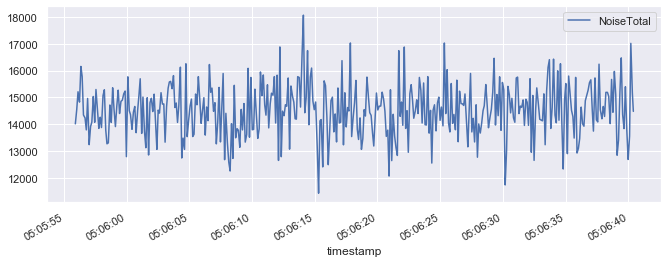

In [74]:
from matplotlib import pyplot
va1.plot()
pyplot.show()

In [75]:
# Use seaborn style defaults and set the default figure size
sns.set(rc={'figure.figsize':(11, 4)})

Index(['NoiseTotal'], dtype='object')

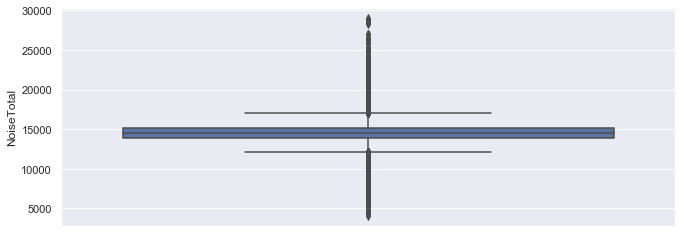

In [76]:
sns.boxplot(data=va, y='NoiseTotal');
va.columns

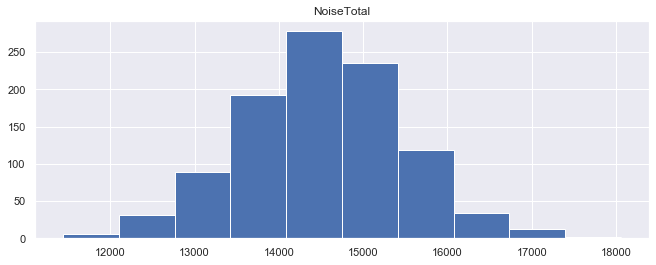

In [77]:
from matplotlib import pyplot
va1.hist()
pyplot.show()

In [78]:
va2 = va[va['NoiseTotal']>va['NoiseTotal'].mean()]
va2

,NoiseTotal
timestamp,
2020-07-16 05:00:00.216000+00:00,14924.000000
2020-07-16 05:00:00.224000+00:00,14869.423788
2020-07-16 05:00:00.886000+00:00,15981.000000
2020-07-16 05:00:00.887000+00:00,15954.528936
2020-07-16 05:00:01.106000+00:00,15063.000000
...,...
2020-07-22 16:59:59.772000+00:00,14957.851558
2020-07-22 16:59:59.872000+00:00,14843.000000
2020-07-22 16:59:59.880000+00:00,14833.117652


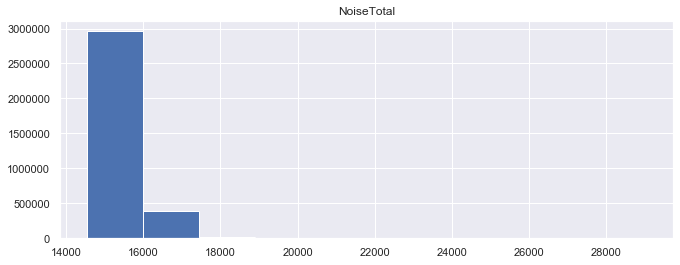

In [79]:
from matplotlib import pyplot
va2.hist()
pyplot.show()

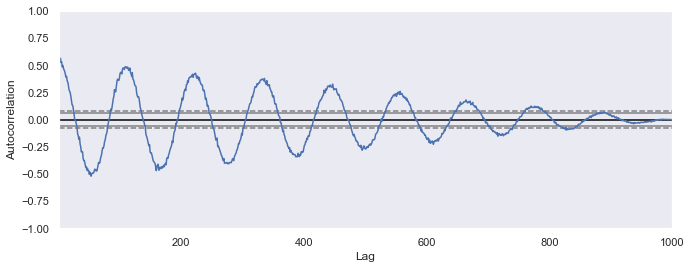

In [80]:
from pandas.plotting import autocorrelation_plot

plt.figure()

spacing = np.linspace(-9 * np.pi, 9 * np.pi, num=1000)

va= pd.Series(0.7 * np.random.rand(1000) + 0.3 * np.sin(spacing))

autocorrelation_plot(va)


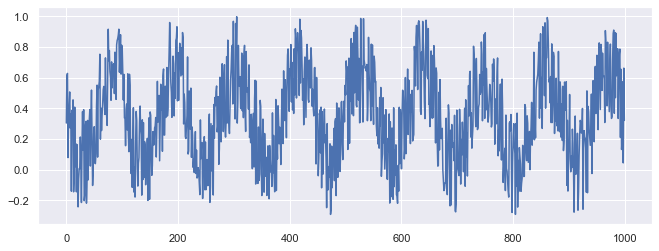

In [81]:
va.plot()

In [82]:
#define function for ADF test

from statsmodels.tsa.stattools import adfuller

def adf_test(timeseries):
    #Perform Dickey-Fuller test:
    print ('Results of Dickey-Fuller Test:')
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print (dfoutput)

#apply adf test on the series
adf_test(va1['NoiseTotal'])

Results of Dickey-Fuller Test:
Test Statistic                -1.411795e+01
p-value                        2.453604e-26
#Lags Used                     2.000000e+00
Number of Observations Used    9.970000e+02
Critical Value (1%)           -3.436926e+00
Critical Value (5%)           -2.864443e+00
Critical Value (10%)          -2.568316e+00
dtype: float64


In [83]:
## Testing for stationarity
from statsmodels.tsa.stattools import adfuller

In [84]:
test_result = adfuller(va1['NoiseTotal'])

In [85]:
#H0: It is not stationary
#H1: It is stationary

def adfuller_test(NoiseTotal):
    result=adfuller(NoiseTotal)
    labels = ['ADF TEST Statistic','p-value','#Lags used', 'Number of Observations Used']
    for value,label in zip(result,labels):
        print(label+' : '+str(value) )
    if result[1] <= 0.05:
        print("strong evidence against the null hypothesis(Ho),reject the null hypothesis.Data has no unit root and is stationary")
    else:
        print("weak evidence against null hypothesis, time series has a unit root, indicating it is not stationary")

In [86]:
adfuller_test(va1['NoiseTotal'])

ADF TEST Statistic : -14.11794916088244
p-value : 2.4536038551503183e-26
#Lags used : 2
Number of Observations Used : 997
strong evidence against the null hypothesis(Ho),reject the null hypothesis.Data has no unit root and is stationary


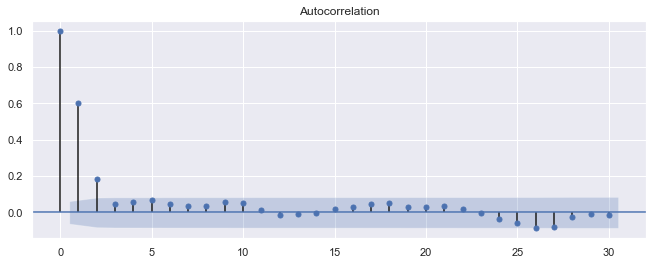

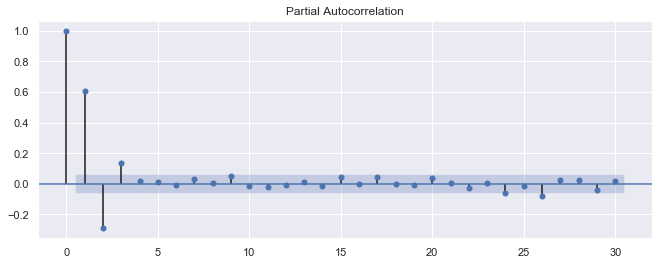

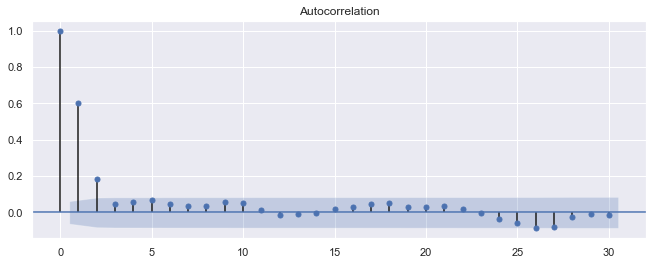

In [87]:
from statsmodels.graphics.tsaplots import plot_pacf,plot_acf
plot_pacf(va1)
plot_acf(va1)

In [88]:
# fitting ARIMA model on entire dataset
from statsmodels.tsa.arima_model import ARIMA

In [95]:
model = ARIMA(va1, order=(5, 1, 3))  
model_fit = model.fit(disp=0)

C:\Users\arrah\Anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:218: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

C:\Users\arrah\Anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:218: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



In [96]:
print(model_fit.summary())

                             ARIMA Model Results                              
Dep. Variable:           D.NoiseTotal   No. Observations:                  999
Model:                 ARIMA(5, 1, 3)   Log Likelihood               -7985.742
Method:                       css-mle   S.D. of innovations            713.403
Date:                Wed, 12 Aug 2020   AIC                          15991.485
Time:                        17:46:22   BIC                          16040.552
Sample:                             1   HQIC                         16010.135
                                                                              
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.1239      0.180      0.690      0.490      -0.228       0.476
ar.L1.D.NoiseTotal     0.6973      0.032     22.036      0.000       0.635       0.759
ar.L2.D.NoiseTotal  

C:\Users\arrah\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



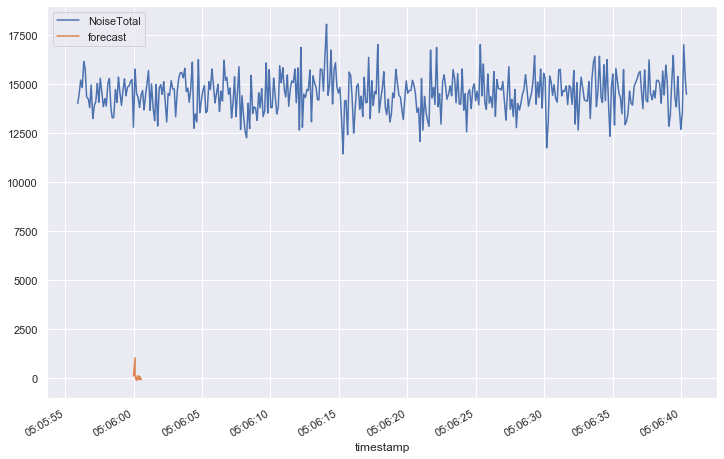

In [97]:
va1['forecast']=model_fit.predict(start=90,end=103,dynamic=True)
va1[['NoiseTotal','forecast']].plot(figsize=(12,8))

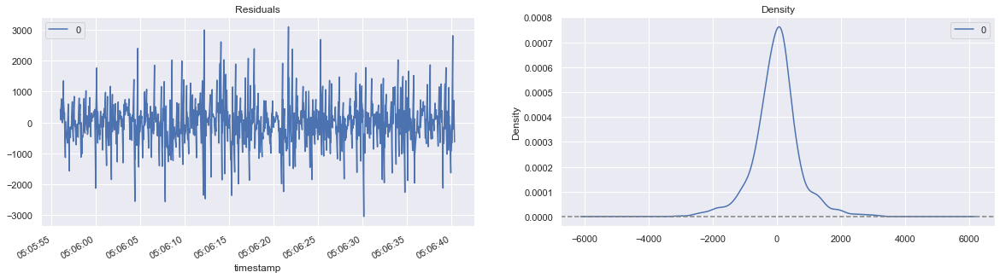

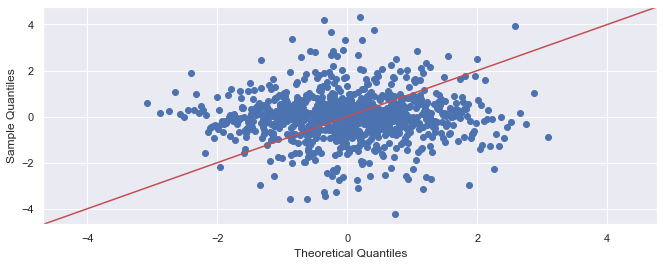

In [98]:
## Plot residual errors
from statsmodels.api import qqplot
residuals = pd.DataFrame(model_fit.resid)
fig, ax = pyplot.subplots(1, 2, figsize=(20, 5))
residuals.plot(title="Residuals", ax=ax[0])
residuals.plot(kind='kde', title='Density', ax=ax[1])
pyplot.axhline(0, linestyle='--', color='grey')
qqplot(residuals, fit=True, line='45')
pyplot.show()

<Figure size 2000x500 with 0 Axes>

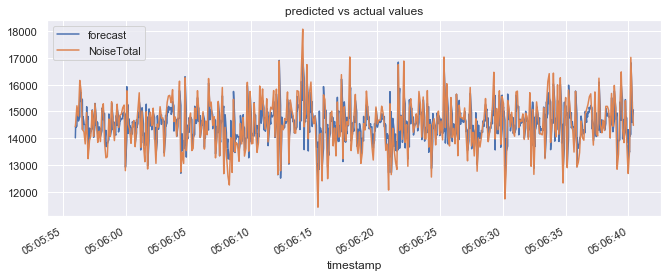

In [47]:
## Actual vs Fitted
pyplot.figure(figsize=(20, 5), dpi=100)
model_fit.plot_predict(dynamic=False)
pyplot.title("predicted vs actual values")
pyplot.show()
